# Calculate growth rates

By this stage, you would have run `get_yearly_data.ipynb` and got yourself nice data. This notebook filters the raw JSON file dumps (remove empty files or those with errors etc) and perform linear regression to estimate annual growth rate of property price (`*_appreciation_rates.xlsx`) and rental income growth (`*_rental_growth.xlsx`), both are exported as Excel files according to the parameters set in the notebook. 

Please consult `README.md` for further information. 

In [1]:
import pandas as pd
import numpy as np
import json
from sklearn.linear_model import LinearRegression
import math
import geopandas
import os
import time
import openpyxl
import re
import scipy

## graphs
# %matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')
from mpl_toolkits.axes_grid1 import make_axes_locatable
import plotly.graph_objects as go
import plotly.express as px


In [2]:
## Select relevant postcodes for Melbourne, Victoria
## set params. Both must be consistent with the downloaded files 
dwellingType = 'House'
numBeds = '3'


Melbourne_Center_Coord = {'lat': -37.814218,'long': 144.963526} # Center of CBD for calculating distance 
radiusZoneInKM = 60 # select postcodes from THIS radius from Melbourne_Center_Coord

exportDir = 'rawDumps_Oct2023' # where json data will be dumped. 

In [3]:
## SECRETS and API KEYS
## Paste your keys here
# domain API
client_id = ''
client_secret = ''
MAPBOX_ACCESSTOKEN = ''


## uploading my access keys
exec(open("access_keys.py", "r").read())


In [4]:
def getMelbourneSuburbs(file="Australian_Post_Codes_Lat_Lon.csv", maxDistance = 30):
    '''Reads a file containing postcodes and locations (lat, long) and returns a DataFrame containing suburns within 30 km of Melbourne CBD.'''
    postcodes = pd.read_csv(file)
    postcodes = postcodes.query('state == "VIC"' )  
    postcodes['inROI'] = postcodes[ ['lat', 'lon'] ].apply(lambda x: isPointInROI(x[0], x[1], maxDistance = maxDistance) , axis = 1)
    postcodes = postcodes[(postcodes.inROI) & (postcodes['postcode'] < 3400) & (postcodes['postcode'] != 3409)]
    return(postcodes)

def isPointInROI(lat, long, maxDistance = 30):
    '''Checks wheather a point on map falls within a square region of interest.
    length of the ROI is maxDistance x 2, with ref coord of melbourne as center (0,0).
    1 degree on lat and long is roughly 110 km. 
    '''    
    return((abs(lat - Melbourne_Center_Coord['lat']) < (maxDistance/110)) &  (abs(long - Melbourne_Center_Coord['long']) < (maxDistance/110)))

def parseJson(json_raw, plotGraph = True, verbose = True):
    import json
    import re
    beds = int(re.findall('\d{1}bd_', json_raw)[0].replace("bd_",""))

    # json_raw = 'data/Prahran_VIC_3181_2bd_house.json'
    f = open (json_raw, "r")
    text = f.read()
    f.close()
    
    if (len(re.findall('400 Bad Request', text)) == 0 and  len(re.findall('Internal Server Error', text)) == 0  ):
        json_list = json.loads(text)
        rawList = json_list['series']['seriesInfo']

        list_df = []

        for i in rawList:
            temp_dict = {}
            temp_dict['month'] = i['month']
            temp_dict['year'] = i['year']   
            temp_dict['year_month'] = str(i['year'])  + "_" + str(i['month'])

            for key, value in i['values'].items():
                temp_dict[key] = value

            list_df.append(temp_dict)

        df = pd.DataFrame(list_df)
        df['suburb'] = json_list['header']['suburb']
        df['propertyCategory'] = json_list['header']['propertyCategory']
        df['bedrooms'] = beds

        if plotGraph:
            plt.plot(df['year'],df['medianSoldPrice'], 'ob-')
            plt.title(str(beds) + " bedroom " + json_list['header']['propertyCategory'] + ", " + json_list['header']['suburb'] + ' (Annual data)'  )
            plt.show()   
        return(df)
    else:
        if (verbose): print("Insufficient data for:",json_raw)
        return([""])

def calculateGrowth_wide(df, factor = 'medianSoldPrice'):
    assert factor in df.columns, "Column " + factor + " not found in df"
    df = df[~df[factor].isnull()] # remove Nan and see remaining data
    if(df.shape[0] > 2 ): # num of non nan rows
        Y = np.log10(np.array(df[factor]).reshape(-1,1))
    #     X = np.array(df.index).reshape(-1,1) # same order as df.year_month
        X = np.array(df.year - 2010).reshape(-1,1)
        reg = LinearRegression().fit(X = X, y = Y)

        stats_dict = {'suburb' : list(df.suburb.unique()),
                      'propertyCategory' : list(df.propertyCategory.unique()),
                      'bedrooms' : list(np.int_(df.bedrooms.unique())),
                    #   'Type' :  factor,
                    factor + '_R-squared': round(reg.score(X, Y),2),
                    factor + '_log10_growth' : list(np.round(reg.coef_[0],4)),
                    factor + '_log10_intercept' : list(np.round(reg.intercept_,2)),
                    factor + '_linear_growth' : [round(10**c,4) for c in list(reg.coef_[0])],
                    factor + '_percent_growth' : [100*(round(10**c,4) - 1) for c in list(reg.coef_[0])],
                    # factor + '_linear_intercept' : [int(10**c) for c in list(reg.intercept_)],
                     factor + '_N' : df.shape[0],
                     factor + '_starting_price' : list(df[df.year == df.year.min()].loc[:,factor]),
                    factor + '_final_price' : list(df[df.year == df.year.max()].loc[:,factor]) }
    else:
        stats_dict = {'suburb' : list(df.suburb.unique()),
              'propertyCategory' : list(df.propertyCategory.unique()),
              'bedrooms' : list(np.int_(df.bedrooms.unique())),
            #   'Type' : factor,
           factor + '_R-squared': None,
            factor + '_log10_growth' : None,
            factor + '_log10_intercept' : None,
            factor + '_linear_growth' : None,
            factor + '_percent_growth' : None,
            # factor + '_linear_intercept' : None,
           factor + '_N' : df.shape[0],
             factor + '_starting_price' : None,
            factor + '_final_price' : None}
        
    return(pd.DataFrame(stats_dict))


## calculate distance from Melbourne
def distance_cbd(lat, long, region = 'Melbourne'):
    major_city_coord = {'Melbourne' : {'lat': -37.814218,'long': 144.963526},
                    'Sydney' : {'lat': -33.87003635458607, 'long': 151.20745239732523},
                    'Parramatta' :{'lat': -33.815101579800746, 'long': 150.99980625492702}
                    }
    assert region in major_city_coord, "Location must be one of :" + major_city_coord.keys()
    '''Checks wheather a point on map falls within a square region of interest.
    length of the ROI is maxDistance x 2, with ref coord of melbourne as center (0,0).
    1 degree on lat and long is roughly 110 km. 
    '''   
    return( np.sqrt(np.power(lat - major_city_coord[region]['lat'], 2) + np.power(long - major_city_coord[region]['long'], 2)))

def drawPropertyMap(df, propertyCategory = "House",  bedrooms = 2, maxFinalPrice = 10**9, showStandardised = True):
    q = 'propertyCategory == "' + propertyCategory +'" & bedrooms == ' + str(bedrooms) + ' & medianSoldPrice_final_price <= ' + str(maxFinalPrice)
    print(q)
#     df.query(q).shape
    geo_df = geopandas.GeoDataFrame(df.query(q))
    print("Results: " + str(geo_df.shape[0]))
    plotTitle = str(bedrooms) + ' bedroom ' + propertyCategory + ' under $' + '{:,.0f}'.format(maxFinalPrice)
    
    #! populate cursor hover text
    my_customData2 = []
    for i in range(geo_df.shape[0]):
        temp_slice = geo_df.iloc[i, ::]
        my_text = temp_slice['suburb'].upper() + \
        ', Property appreciation rate: '+ str(temp_slice['medianSoldPrice_percent_growth']) + \
        ', N =' + str(temp_slice['medianSoldPrice_N']) + \
        ', R^2 = ' + str(temp_slice['medianSoldPrice_R-squared']) + \
        ', Current median price:$ ' + str(temp_slice['medianSoldPrice_final_price']) +  \
        ', Current median Rent: $' + str(temp_slice['medianRentListingPrice_final_price']) + \
        ', Rental growth: ' + str(temp_slice['medianRentListingPrice_percent_growth']) +'% pa'
        my_customData2.append(my_text)
    


    ## plotting
    lga_json = geo_df.__geo_interface__
    if showStandardised:
        geo_df['medianSoldPrice_percent_growth_standardised'] = scipy.stats.zscore(list(geo_df['medianSoldPrice_percent_growth']))
        fillValues = geo_df['medianSoldPrice_percent_growth_standardised']
        zmin = geo_df['medianSoldPrice_percent_growth_standardised'].min()
        zmax = geo_df['medianSoldPrice_percent_growth_standardised'].max()
        my_hoverTemplate = "<b>Std Growth: %{text} </b><br>" + '%{customdata}' + "<extra></extra>"
        my_colour_palette = 'PRGn'
    else: 
        fillValues = geo_df['medianSoldPrice_percent_growth']
        zmin = geo_df['medianSoldPrice_percent_growth'].min()
        zmax = geo_df['medianSoldPrice_percent_growth'].max()
        my_hoverTemplate = "<b>Growth: %{text} </b><br>" + '%{customdata}' + "<extra></extra>"
        my_colour_palette = 'Blues'
    
    # print(lga_json)
    # print(geo_df.suburb)
    # Set the data for the map
    data = go.Choroplethmapbox(
            geojson = lga_json,             #this is your GeoJSON
            locations = geo_df.index,    #the index of this dataframe should align with the 'id' element in your geojson
            z = fillValues, #sets the color value
            customdata = my_customData2,
            text = fillValues,    #sets text for each shape
            colorbar = dict(thickness=20, ticklen=3,outlinewidth=0), #adjusts the format of the colorbar
            marker_line_width=1, marker_opacity=0.7, 
            colorscale= my_colour_palette , # Viridis_r adjust format of the plot
            zmin = zmin, zmax = zmax,           #sets min and max of the colorbar
            hovertemplate = my_hoverTemplate)  # sets the format of the text shown when you hover over each shape

    # Set the layout for the map
    layout = go.Layout(
        title = {'text': plotTitle,
                'font': {'size':24}},       #format the plot title
        mapbox1 = dict(
            domain = {'x': [0, 1],'y': [0, 1]}, 
            center = dict(lat=-37.814218 , lon=144.963526),
            accesstoken = MAPBOX_ACCESSTOKEN, 
            zoom = 8.5),                      
        autosize=True,
        height=600,
        margin=dict(l=0, r=0, t=40, b=0))

    # Generate the map
    fig=go.Figure(data=data, layout=layout)
    fig.show()


# Preperation

In [5]:
##! prepare data frame containing suburb codes and names as well as suburb boundries from .shp files.
##! ROI = region of interest
postcodes = getMelbourneSuburbs(maxDistance = radiusZoneInKM)

## coordinates of suburbs and add that to postcodes
aus_poas = geopandas.read_file('aus_poas.shp')

postcodes = postcodes.merge(aus_poas,how='inner', left_on = ['postcode','state'], right_on = ['code','state'])
postcodes = postcodes.drop(['code', 'POA_NAME'], axis=1)
postcodes.suburb = postcodes.suburb.apply(lambda x: x.lower())
print("{} records selected".format(str(postcodes.shape[0])))
postcodes.head()

/Users/jsha0071/miniconda3/lib/python3.9/site-packages/pandas/core/frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


487 records selected


,postcode,suburb,state,dc,type,lat,lon,inROI,geometry
0,3000,melbourne,VIC,CITY DELIVERY CENTRE,Delivery Area,-37.814563,144.970267,True,"MULTIPOLYGON (((144.97238 -37.80992, 144.97247..."
1,3002,east melbourne,VIC,CITY DELIVERY CENTRE,Delivery Area,-37.816640,144.987811,True,"MULTIPOLYGON (((144.97395 -37.81332, 144.97362..."
2,3003,west melbourne,VIC,CITY DELIVERY CENTRE,Delivery Area,-37.806255,144.941123,True,"POLYGON ((144.90644 -37.80885, 144.90671 -37.8..."
3,3004,melbourne,VIC,CITY DELIVERY CENTRE,Delivery Area,-37.837324,144.976335,True,"POLYGON ((144.97909 -37.84597, 144.97869 -37.8..."
4,3005,world trade centre,VIC,CITY DELIVERY CENTRE,Delivery Area,-37.822262,144.954856,True,"POLYGON ((144.95155 -37.81978, 144.95415 -37.8..."


In [6]:
## calculate growth rates
## Get all files from a folder and loop over for linear regression
## MUST BE ANNUAL rawDumps data, not api_quarters.
## Use 1_get_yearly_data.ipynb first to get data in json format.
files = os.listdir(exportDir)
files = [f for f in files if f.endswith(".json")]
print("- {} raw json files found in {}".format(str(len(files)), exportDir))

##! remove empty files or insuffient data 
files = [c for c in files if os.stat(os.path.join(exportDir, c)).st_size > 4000 ]
print("- {} json files > 4 kb".format(str(len(files))))

files = [c for c in files if c.split('_')[4] == dwellingType and c.split('_')[3] == (numBeds)+"bd"  ]
print("- {} files for {} bd {}".format(str(len(files)), str(numBeds), dwellingType ) )

- 399 raw json files found in rawDumps_Oct2023
- 339 json files > 4 kb
- 215 files for 3 bd House


# Test conversion of json to data frame before performing regression

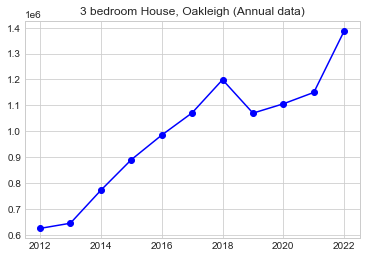

,month,year,year_month,medianSoldPrice,numberSold,highestSoldPrice,lowestSoldPrice,5thPercentileSoldPrice,25thPercentileSoldPrice,75thPercentileSoldPrice,...,auctionNumberWithdrawn,daysOnMarket,discountPercentage,medianRentListingPrice,numberRentListing,highestRentListingPrice,lowestRentListingPrice,suburb,propertyCategory,bedrooms
0,7,2012,2012_7,625000,46,866000,340000,470000,560000,680000,...,None,57,None,420,88,640,110,Oakleigh,House,3
1,7,2013,2013_7,645000,47,1020000,365000,455000,585000,737000,...,None,59,None,420,80,650,340,Oakleigh,House,3
2,7,2014,2014_7,772000,59,7000000,343000,536000,650000,870000,...,None,50,None,433,92,660,320,Oakleigh,House,3
3,7,2015,2015_7,890000,62,1626000,535000,630000,785000,1021000,...,None,52,None,453,80,660,280,Oakleigh,House,3
4,7,2016,2016_7,985000,49,1660000,600000,720000,902000,1100000,...,None,16,None,465,71,660,330,Oakleigh,House,3
5,7,2017,2017_7,1071000,43,2525000,791000,830000,969000,1245000,...,None,62,None,480,55,700,300,Oakleigh,House,3
6,7,2018,2018_7,1199000,40,1750000,800000,826000,1030000,1320000,...,None,36,None,510,45,2281,300,Oakleigh,House,3
7,7,2019,2019_7,1070000,23,1500000,700000,835000,880000,1150000,...,None,76,None,498,44,699,385,Oakleigh,House,3
8,7,2020,2020_7,1106000,30,1760000,725000,870000,990000,1205000,...,None,58,None,545,73,950,380,Oakleigh,House,3
9,7,2021,2021_7,1150000,29,1771000,415000,712000,900000,1360000,...,None,168,None,498,60,795,345,Oakleigh,House,3


In [7]:
##! Hopefully this will plot a graph and display table of raw json converted to a data frame
testFile = exportDir + "/3166_OAKLEIGH_VIC_3bd_House_years_raw.json"
parsed_df = parseJson(testFile, plotGraph=True, verbose = True)
parsed_df

In [8]:
calculateGrowth_wide(parsed_df) # reports appreciation rate in 'wide' format

,suburb,propertyCategory,bedrooms,medianSoldPrice_R-squared,medianSoldPrice_log10_growth,medianSoldPrice_log10_intercept,medianSoldPrice_linear_growth,medianSoldPrice_percent_growth,medianSoldPrice_N,medianSoldPrice_starting_price,medianSoldPrice_final_price
0,Oakleigh,House,3,0.87,0.0314,5.76,1.0749,7.49,11,625000,1388000


# Estimate property growth rate from downloaded data

In [9]:
# #### calculate appreciation
showRecords = False # whether to show number of annual records found in each json.
property_appreciation = [] # this is where results of each iteration will be stored
for my_file in files:
#     print(my_file)
    parsed_df =  parseJson(os.path.join(exportDir, my_file), plotGraph=False, verbose = False)
    if showRecords:
        print("{} records in: {}".format(str(parsed_df.shape[0]), my_file ))
    if(not isinstance(parsed_df, list)):
        a = calculateGrowth_wide(parsed_df)
        property_appreciation.append(a)
print("-- Growth rate calculated  --")

    

-- Growth rate calculated  --


In [10]:
appreciation_rates = pd.concat(property_appreciation, axis= 0)
appreciation_rates.suburb = appreciation_rates.suburb.apply(lambda x: x.lower())
# print("shape:", appreciation_rates.shape)

## add postcodes for each suburn name
appreciation_rates = appreciation_rates.merge(postcodes, how = 'inner', on=['suburb'])

## Some people may want to live close to the city. 
## estimate distance to city, in lat and long - NOT  in KM. 
## this is empirical and we haven't corrected for the Earth's curvature. Sorry, flatearthers. 
appreciation_rates['prox_city'] = appreciation_rates[['lat', 'lon']].apply(lambda x: distance_cbd(x[0], x[1],'Melbourne'), axis=1)

## 
appreciation_rates.head(3)

,suburb,propertyCategory,bedrooms,medianSoldPrice_R-squared,medianSoldPrice_log10_growth,medianSoldPrice_log10_intercept,medianSoldPrice_linear_growth,medianSoldPrice_percent_growth,medianSoldPrice_N,medianSoldPrice_starting_price,medianSoldPrice_final_price,postcode,state,dc,type,lat,lon,inROI,geometry,prox_city
0,moorabbin,House,3.0,0.9,0.033,5.72,1.079,7.9,11,595000,1333000,3189,VIC,MOORABBIN DELIVERY CENTRE,Delivery Area,-37.934352,145.036735,True,"POLYGON ((145.06727 -37.94864, 145.06683 -37.9...",0.140683
1,donvale,House,3.0,0.86,0.0296,5.72,1.0704,7.04,11,582000,1262000,3111,VIC,TEMPLESTOWE DC,Delivery Area,-38.183899,144.468019,True,"POLYGON ((145.21120 -37.80909, 145.21119 -37.8...",0.618216
2,kew,House,3.0,0.81,0.0216,6.07,1.051,5.1,11,1205000,2085000,3101,VIC,DEEPDENE DC,Delivery Area,-37.797982,145.053727,True,"POLYGON ((145.02045 -37.79813, 145.02020 -37.7...",0.091651


In [11]:
## tidy up before exporting. Select or rename column names. 
## 'medianSoldPrice' prefix was added to emphasize on which data we were referring to 
# print(appreciation_rates.columns)
appreciation_rates = appreciation_rates[['postcode', 'suburb', 'propertyCategory', 'bedrooms', 'medianSoldPrice_percent_growth', \
                                        'medianSoldPrice_N', 'medianSoldPrice_R-squared', 'medianSoldPrice_final_price', 'lat', 'lon','prox_city'  ] ]

appreciation_rates.head()

,postcode,suburb,propertyCategory,bedrooms,medianSoldPrice_percent_growth,medianSoldPrice_N,medianSoldPrice_R-squared,medianSoldPrice_final_price,lat,lon,prox_city
0,3189,moorabbin,House,3.0,7.9,11,0.9,1333000,-37.934352,145.036735,0.140683
1,3111,donvale,House,3.0,7.04,11,0.86,1262000,-38.183899,144.468019,0.618216
2,3101,kew,House,3.0,5.1,11,0.81,2085000,-37.797982,145.053727,0.091651
3,3153,bayswater,House,3.0,7.6,11,0.89,860000,-37.841260,145.266725,0.304403
4,3122,hawthorn,House,3.0,5.96,11,0.89,2168000,-37.834855,145.052097,0.090943


In [12]:
## export
appreciation_rates.to_excel(str(numBeds) +'bd_' + dwellingType + '_appreciation_rates.xlsx',index=False)

In [13]:
## explore indivial suburbs by plotting data by going back to 'testing' section

In [14]:
appreciation_rates.head()

,postcode,suburb,propertyCategory,bedrooms,medianSoldPrice_percent_growth,medianSoldPrice_N,medianSoldPrice_R-squared,medianSoldPrice_final_price,lat,lon,prox_city
0,3189,moorabbin,House,3.0,7.9,11,0.9,1333000,-37.934352,145.036735,0.140683
1,3111,donvale,House,3.0,7.04,11,0.86,1262000,-38.183899,144.468019,0.618216
2,3101,kew,House,3.0,5.1,11,0.81,2085000,-37.797982,145.053727,0.091651
3,3153,bayswater,House,3.0,7.6,11,0.89,860000,-37.841260,145.266725,0.304403
4,3122,hawthorn,House,3.0,5.96,11,0.89,2168000,-37.834855,145.052097,0.090943


# Calculate growth in median rent

In [15]:
rental_appreciation = []
for my_file in files:
    parsed_df =  parseJson(exportDir + "/"+ my_file, plotGraph=False, verbose = False)
    if(not isinstance(parsed_df, list)):
        a = calculateGrowth_wide(parsed_df, factor='medianRentListingPrice')
        rental_appreciation.append(a)
print("-- Rental growth rate calculated  --") 



-- Rental growth rate calculated  --


In [16]:
rentGrowth_rates = pd.concat(rental_appreciation, axis= 0)
rentGrowth_rates.suburb = rentGrowth_rates.suburb.apply(lambda x: x.lower())
print("shape:", rentGrowth_rates.shape)

rentGrowth_rates.head()


shape: (185, 11)


,suburb,propertyCategory,bedrooms,medianRentListingPrice_R-squared,medianRentListingPrice_log10_growth,medianRentListingPrice_log10_intercept,medianRentListingPrice_linear_growth,medianRentListingPrice_percent_growth,medianRentListingPrice_N,medianRentListingPrice_starting_price,medianRentListingPrice_final_price
0,moorabbin,House,3.0,0.9,0.0129,2.61,1.0301,3.01,11,448,595
0,travancore,House,3.0,0.98,0.0038,2.73,1.0089,0.89,3,560.0,598.0
0,donvale,House,3.0,0.8,0.0074,2.6,1.0172,1.72,11,415,500
0,kew,House,3.0,0.9,0.0064,2.77,1.0147,1.47,11,590,695
0,bayswater,House,3.0,0.99,0.0113,2.51,1.0263,2.63,11,340,440


In [17]:
rentGrowth_rates.to_excel(str(numBeds) +'bd_' + dwellingType + "_rental_growth.xlsx", index=False)
print("-- done --")

-- done --


In [18]:
rentGrowth_rates = rentGrowth_rates.merge(postcodes, how = 'inner', on=['suburb'])
rentGrowth_rates.shape
rentGrowth_rates.head()
print("-- done --")

-- done --


In [19]:
## Add suburb shape info
appreciation_rates = appreciation_rates.merge(postcodes[['suburb', 'postcode', 'geometry']],
                                  how = 'inner', 
                                  on=['suburb', 'postcode'])
df = appreciation_rates.merge(rentGrowth_rates, how = 'inner')
df = df.dropna()
df.head()

,postcode,suburb,propertyCategory,bedrooms,medianSoldPrice_percent_growth,medianSoldPrice_N,medianSoldPrice_R-squared,medianSoldPrice_final_price,lat,lon,...,medianRentListingPrice_log10_intercept,medianRentListingPrice_linear_growth,medianRentListingPrice_percent_growth,medianRentListingPrice_N,medianRentListingPrice_starting_price,medianRentListingPrice_final_price,state,dc,type,inROI
0,3189,moorabbin,House,3.0,7.9,11,0.9,1333000,-37.934352,145.036735,...,2.61,1.0301,3.01,11,448,595,VIC,MOORABBIN DELIVERY CENTRE,Delivery Area,True
1,3111,donvale,House,3.0,7.04,11,0.86,1262000,-38.183899,144.468019,...,2.6,1.0172,1.72,11,415,500,VIC,TEMPLESTOWE DC,Delivery Area,True
2,3101,kew,House,3.0,5.1,11,0.81,2085000,-37.797982,145.053727,...,2.77,1.0147,1.47,11,590,695,VIC,DEEPDENE DC,Delivery Area,True
3,3153,bayswater,House,3.0,7.6,11,0.89,860000,-37.841260,145.266725,...,2.51,1.0263,2.63,11,340,440,VIC,BAYSWATER DC,Delivery Area,True
4,3122,hawthorn,House,3.0,5.96,11,0.89,2168000,-37.834855,145.052097,...,2.79,1.0211,2.11,11,650,795,VIC,HAWTHORN DELIVERY CENTRE,Delivery Area,True


# Visualise!
Note that this is interactive. Feel free to reset the graph, crop etc.

Two ways to visualise the data: standardised (`showStandardised = True`) and actual values (`showStandardised = False`). Displaying standardised values shows suburbs which appreciate above or below market average. Actual values colour code based on estimated growth rates. 

`maxFinalPrice` is set to be very high to show overall picture. Feel free to change this to suit your budget. 


In [20]:
drawPropertyMap(df,'House', 3, maxFinalPrice = 8000000000, showStandardised = True) 

propertyCategory == "House" & bedrooms == 3 & medianSoldPrice_final_price <= 8000000000
Results: 171
